# Project 4 : Advanced Lane Lines

## Camera Calibration

In [1]:
# Load modules
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
import pickle
import scipy.misc
%matplotlib inline


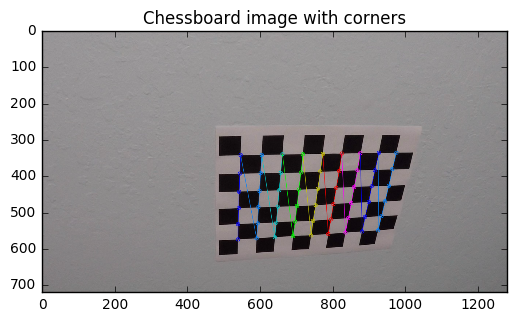

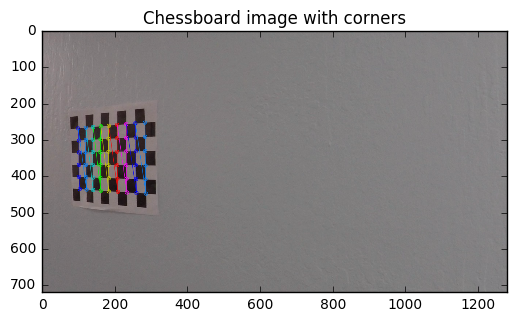

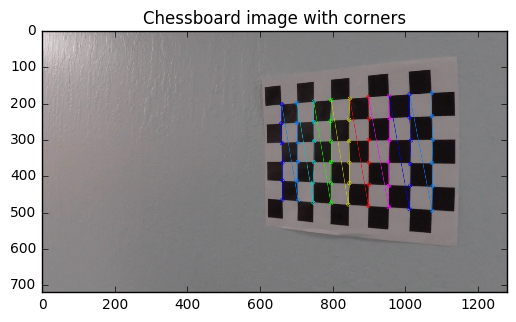

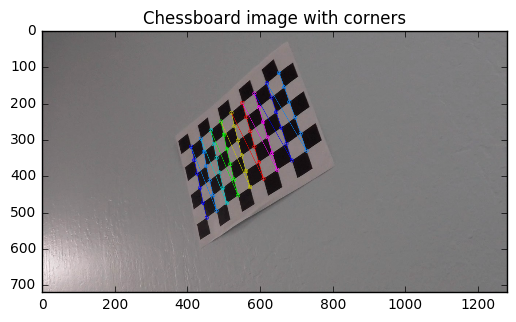

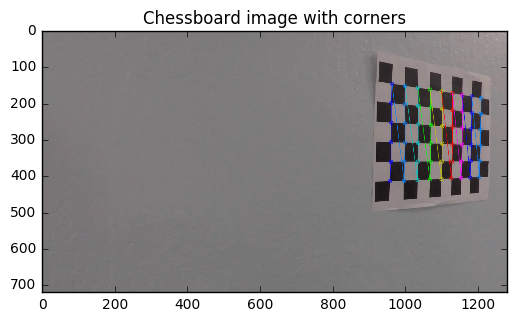

...

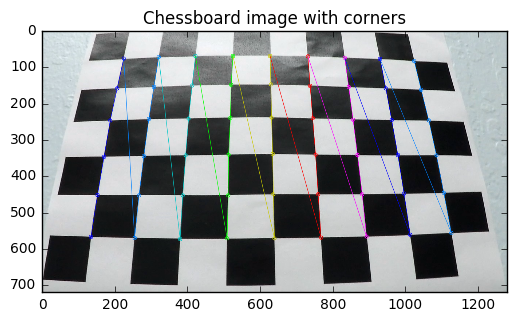

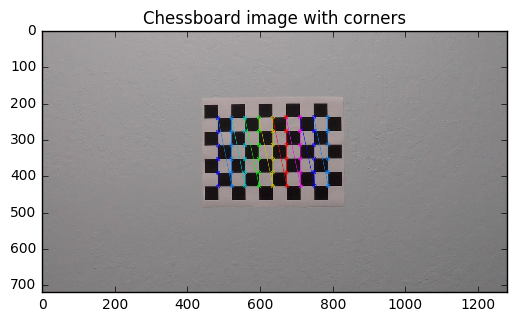

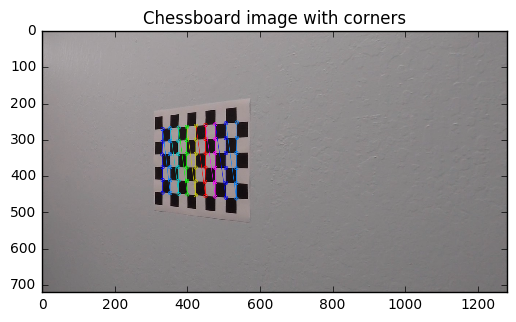

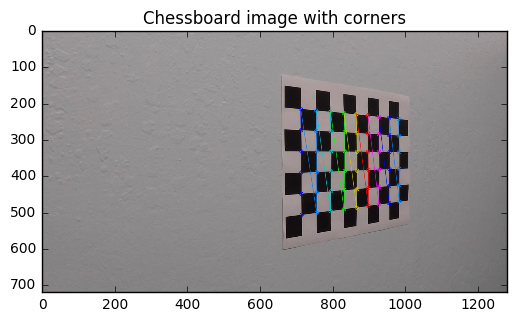

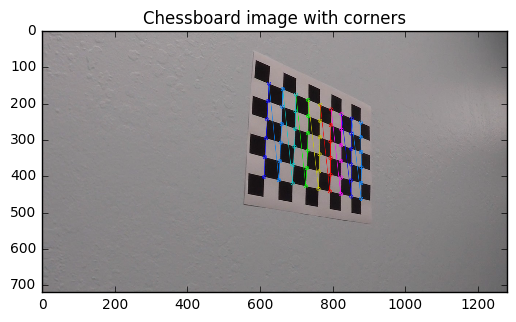

In [2]:
# Constants definitions
nx = 9 # Number of interior horizontal corners
ny = 6 # Number of interior vertical corners

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Prepare object points, like (0,0,0), (1,0,0)...
objp = np.zeros((ny*nx,3), np.float32)
objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (ny,nx), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        cv2.drawChessboardCorners(img, (ny,nx), corners, ret)
        plt.imshow(img)
        plt.title("Chessboard image with corners")
        plt.show()

## Distorsion Correction

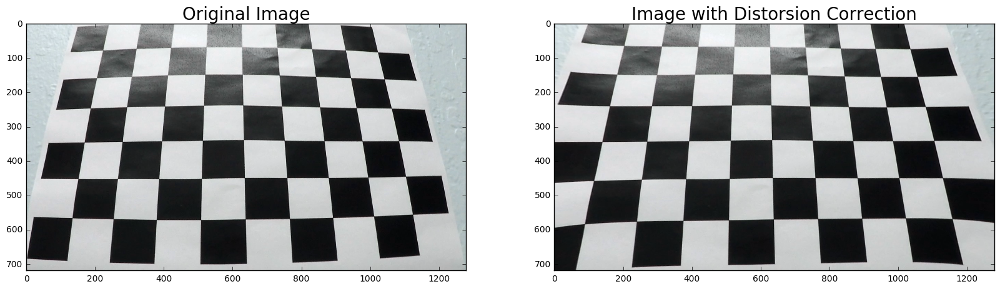

In [3]:
# Test undistortion on an image
img = cv2.imread('camera_cal/calibration3.jpg')
img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)


dst = cv2.undistort(img, mtx, dist, None, mtx)
cv2.imwrite('camera_cal/test_undist.jpg',dst)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "camera_cal/wide_dist_pickle.p", "wb" ) )
#dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=20)
ax2.imshow(dst)
ax2.set_title('Image with Distorsion Correction', fontsize=20)

filename = 'output_images/UndistorsionedImage'+'.jpg'
scipy.misc.imsave(filename, dst)

## Thresholded binary image

In [4]:
def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply cv2.Sobel() 
    # Take the absolute value of the output from cv2.Sobel()
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # Scale the result to an 8-bit range (0-255)
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Apply lower and upper thresholds
    binary_output = np.zeros_like(scaled_sobel)
    # Create binary_output
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    
    return binary_output


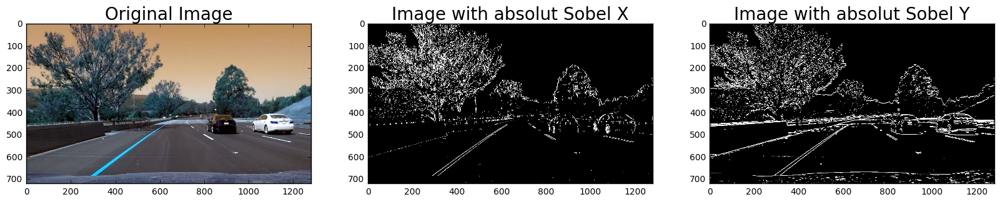

In [5]:
# Test in 1 image
img = cv2.imread('test_images/test6.jpg')
img_sobel_x = abs_sobel_thresh(img,'x',30,200)
img_sobel_y = abs_sobel_thresh(img,'y',30,200)

f, (ax1, ax2 , ax3) = plt.subplots(1, 3, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=20)
ax2.imshow(img_sobel_x, cmap='gray')
ax2.set_title('Image with absolut Sobel X', fontsize=20)
ax3.imshow(img_sobel_y, cmap='gray')
ax3.set_title('Image with absolut Sobel Y', fontsize=20)


In [6]:
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output

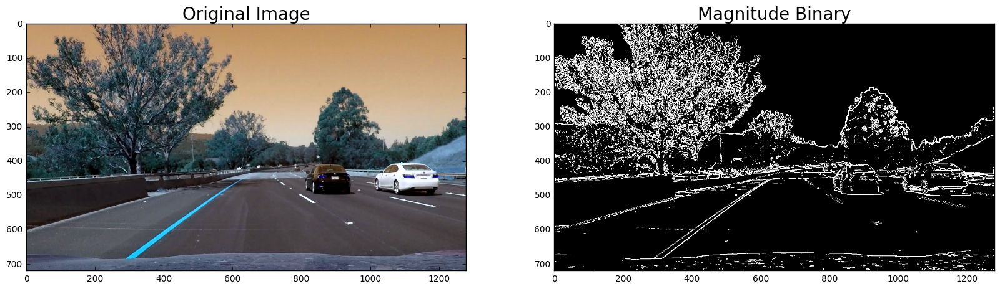

In [7]:
# Test in 1 image
img = cv2.imread('test_images/test6.jpg')
mag_binary = mag_thresh(img, sobel_kernel=3, mag_thresh=(30, 100))

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=20)
ax2.imshow(mag_binary, cmap='gray')
ax2.set_title('Magnitude Binary', fontsize=20)

    

In [8]:
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return binary_output

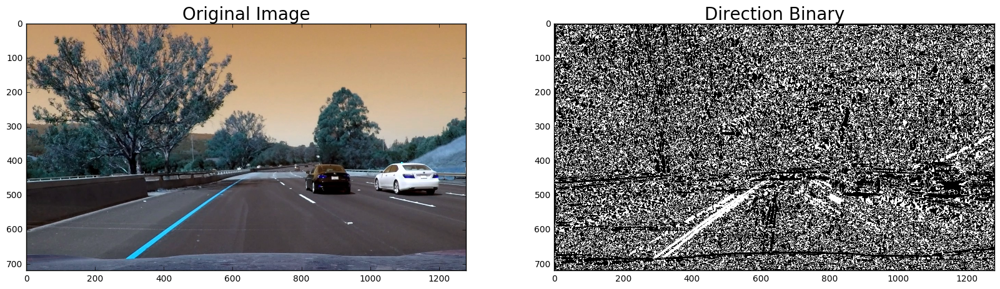

In [9]:
# Test in 1 image
img = cv2.imread('test_images/test6.jpg')
dir_binary = dir_threshold(img, sobel_kernel=15, thresh=(0.7, 1.3))

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=20)
ax2.imshow(dir_binary, cmap='gray')
ax2.set_title('Direction Binary', fontsize=20)


In [10]:
def pipeline_gray (img):
    # Calibration parameters
    thres_abs_max_sx = 255
    thres_abs_min_sx = 10
    thres_abs_max_sy = 255
    thres_abs_min_sy = 60
    mag_thres = (40,255)
    kernel_mag = 5 # Kernel size for magnitude threshold
    dir_thres = (.65,1.05)
    kernel_dir = 5
    
    # Grayscale image
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # Apply thresholding functions
    abs_gradx = abs_sobel_thresh(img,'x', thres_abs_min_sx, thres_abs_max_sx)
    abs_grady = abs_sobel_thresh(img,'y', thres_abs_min_sy, thres_abs_max_sy)
    mag = mag_thresh(img, kernel_mag, mag_thres)
    dir_grad = dir_threshold(img, kernel_dir, dir_thres)
    
    # Join the thresholding
    thresholds_all = np.zeros_like (dir_grad)
    thresholds_all[((abs_gradx == 1) & (abs_grady == 1)) | ((mag == 1) & (dir_grad == 1))] = 1
    
    return thresholds_all
    

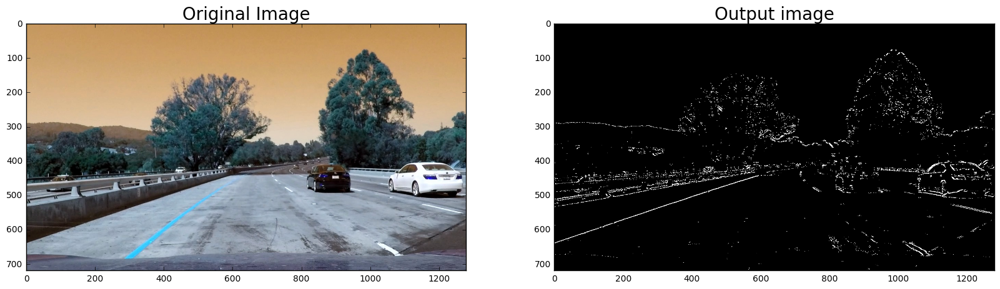

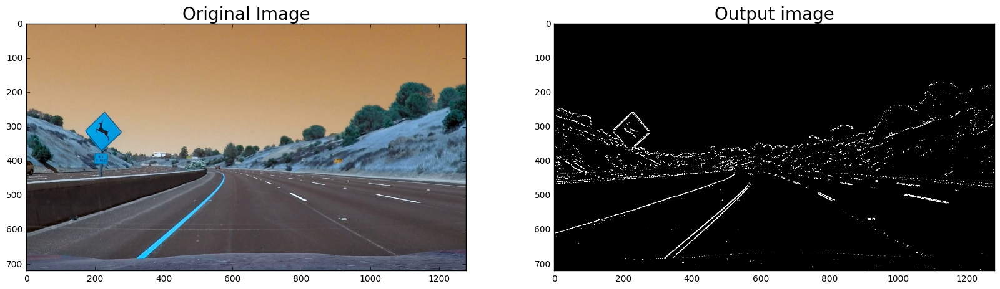

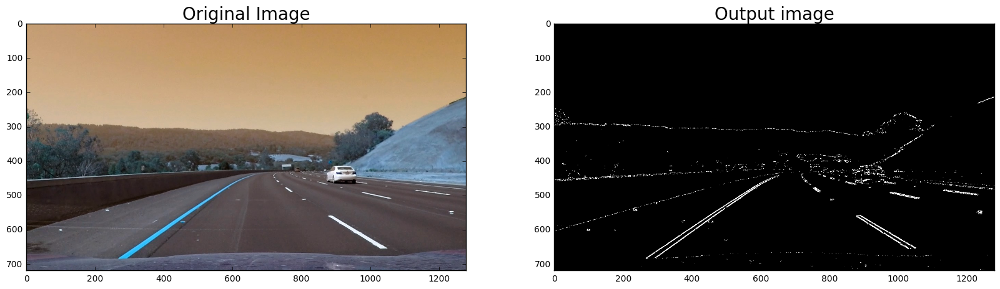

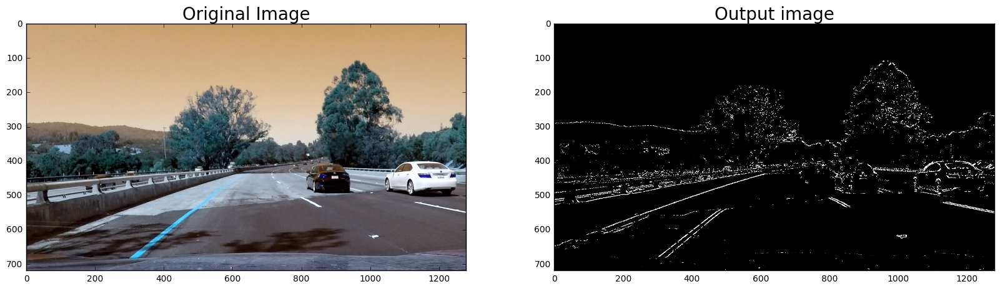

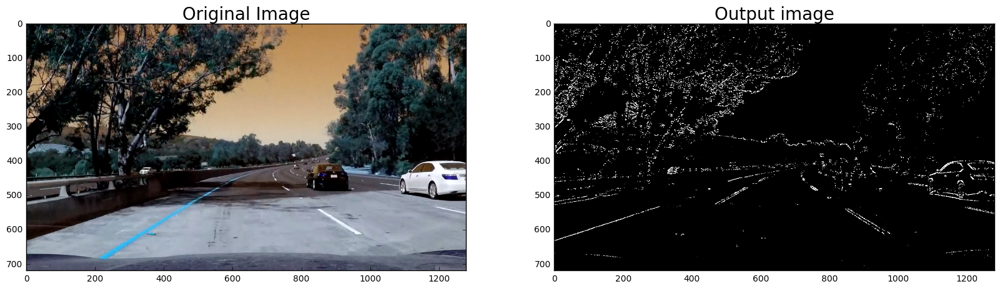

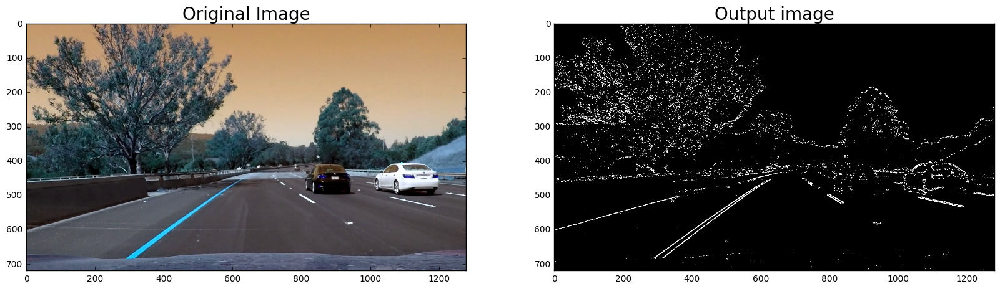

In [11]:
# Test in images
test_images = glob.glob('test_images/test*.jpg')

for idx, fname in enumerate(test_images):
    img = cv2.imread(fname)
    output_img = pipeline_gray (img)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(output_img, cmap='gray')
    ax2.set_title('Output image', fontsize=20)

In [12]:
def pipeline_color(img):
    
    # Calibration parameters
    thres_color_min = 160
    thres_color_max = 255
    # Convert to HLS color space and separate the S channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s = hls[:,:,2]
    
    # Threshold color channel
    s_binary = np.zeros_like(s)
    s_binary[(s > thres_color_min) & (s < thres_color_max)] = 1
    
    
    return s_binary

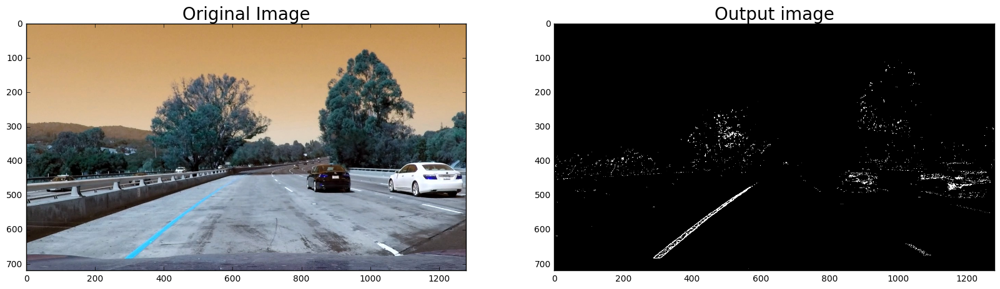

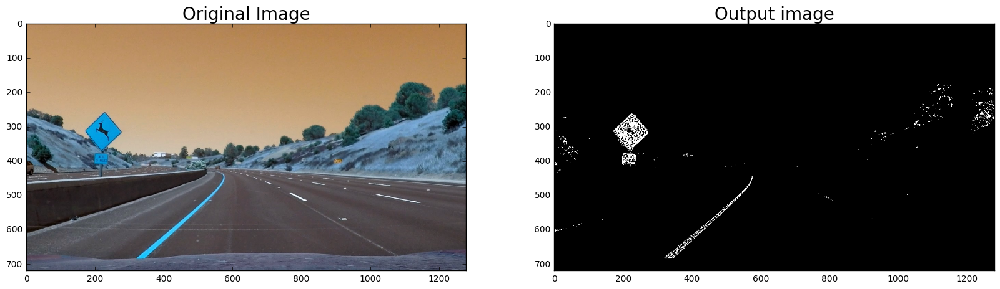

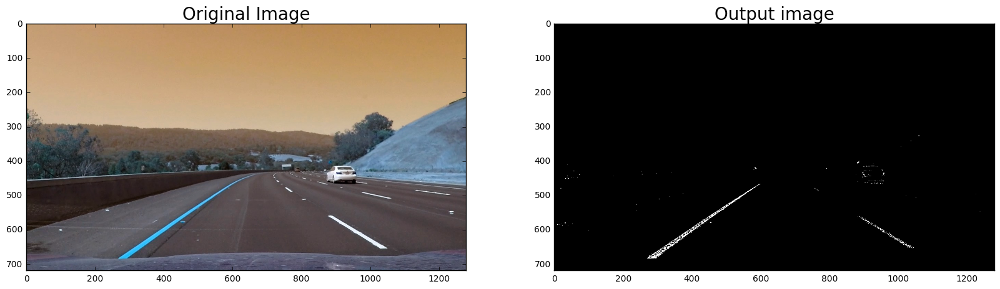

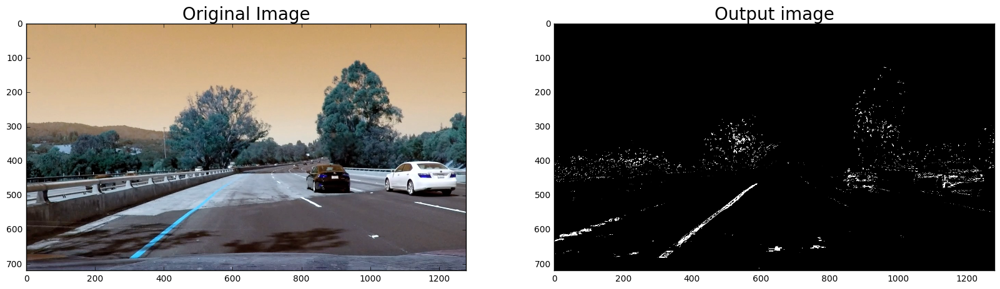

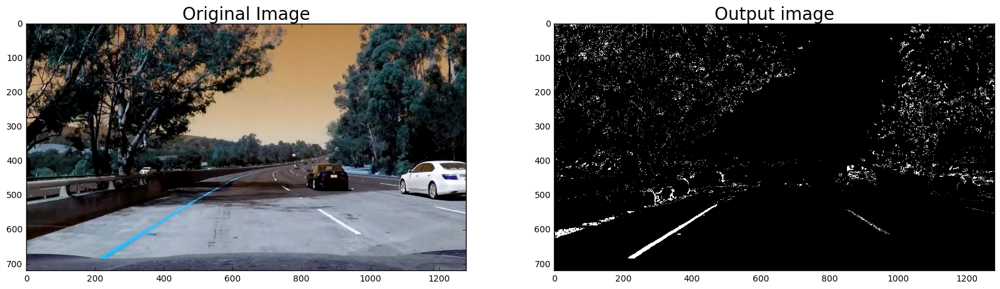

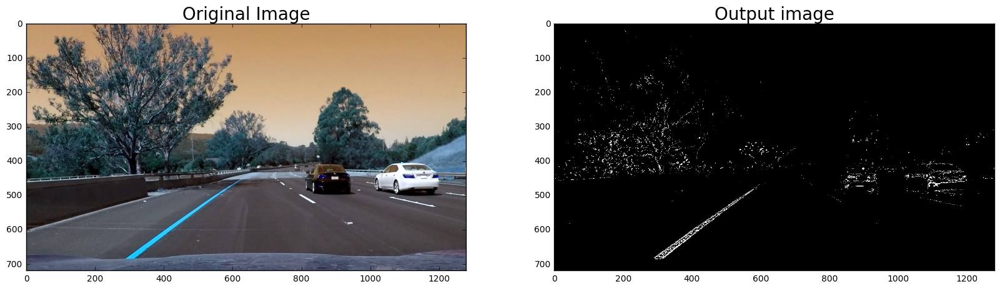

In [13]:
# Test in images
test_images = glob.glob('test_images/test*.jpg')

for idx, fname in enumerate(test_images):
    img = cv2.imread(fname)
    output_img = pipeline_color (img)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(output_img, cmap='gray')
    ax2.set_title('Output image', fontsize=20)

In [14]:
def pipeline_all (img):
    
    img_pipe_gray = pipeline_gray(img)
    img_pipe_color = pipeline_color(img)
    temp = img_pipe_gray
    img_pipe_all = np.zeros_like(temp)
    img_pipe_all[(img_pipe_color > 0) | (img_pipe_gray > 0)] = 1
    
    return img_pipe_all

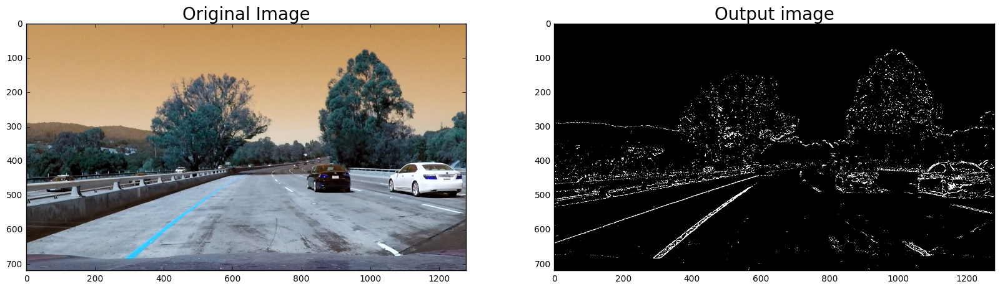

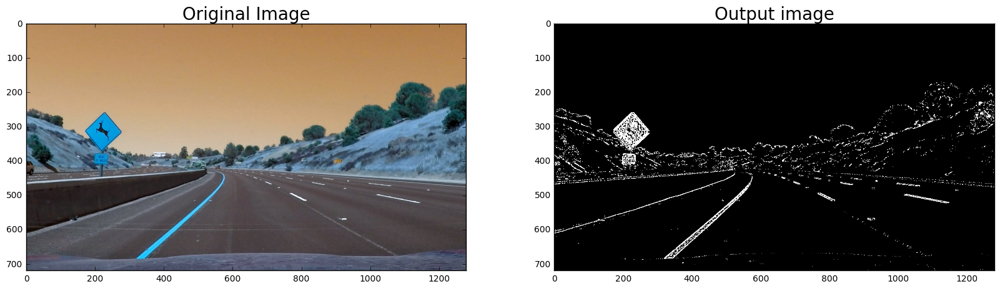

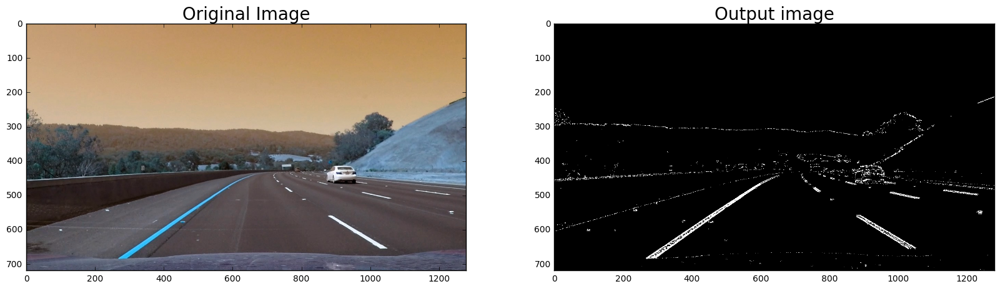

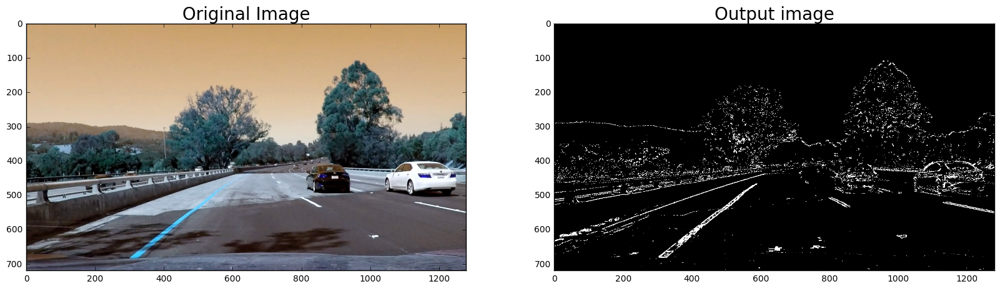

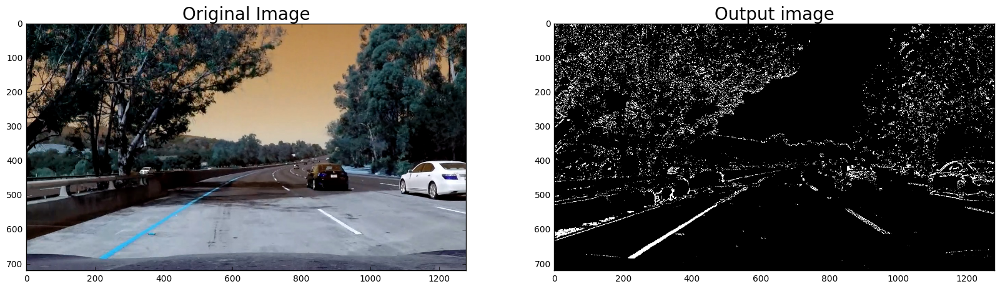

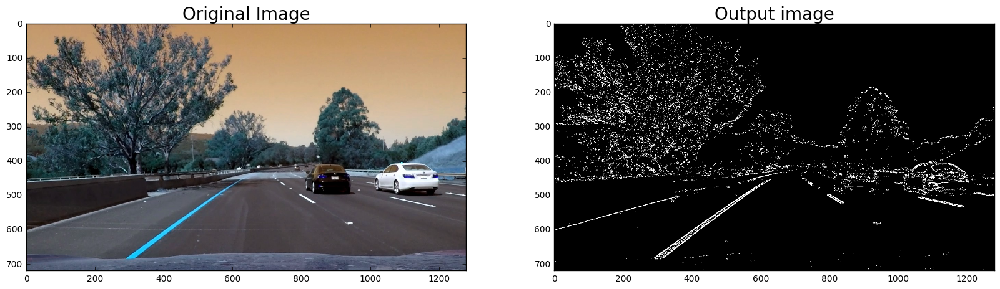

In [15]:
# Test in images
test_images = glob.glob('test_images/test*.jpg')

for idx, fname in enumerate(test_images):
    img = cv2.imread(fname)
    output_img = pipeline_all (img)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(output_img, cmap='gray')
    ax2.set_title('Output image', fontsize=20)

At this point, we're able to distingish the lines. However there is a lot of noise in the image and we have to only focus in the lane lines. So, it is required to apply a Region of Interest in the image in order to remove noise from the image.

In [16]:
def ROI (img,bottom_left,bottom_right, upper_left, upper_right):
    
    mask = np.zeros_like(img)   
    area = np.array([[bottom_left, bottom_right,upper_right,upper_left]], dtype=np.int32)
    
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
    
    cv2.fillPoly(mask, area , ignore_mask_color)
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    
    return masked_image

c:\users\xavisilvia\appdata\local\programs\python\python35\lib\site-packages\scipy\misc\pilutil.py:96: RuntimeWarning: overflow encountered in double_scalars
  scale = float(high - low) / cscale
c:\users\xavisilvia\appdata\local\programs\python\python35\lib\site-packages\scipy\misc\pilutil.py:97: RuntimeWarning: invalid value encountered in multiply
  bytedata = (data * 1.0 - cmin) * scale + 0.4999
c:\users\xavisilvia\appdata\local\programs\python\python35\lib\site-packages\scipy\misc\pilutil.py:98: RuntimeWarning: invalid value encountered in greater
  bytedata[bytedata > high] = high
c:\users\xavisilvia\appdata\local\programs\python\python35\lib\site-packages\scipy\misc\pilutil.py:99: RuntimeWarning: invalid value encountered in less
  bytedata[bytedata < 0] = 0


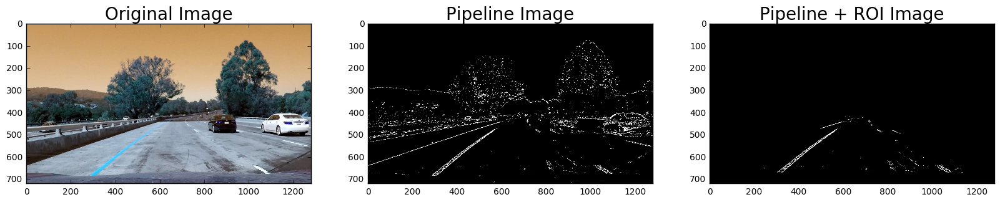

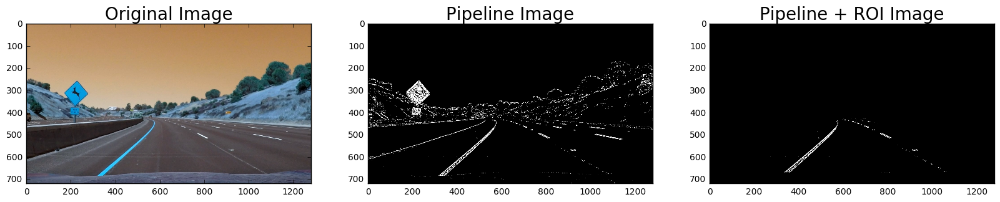

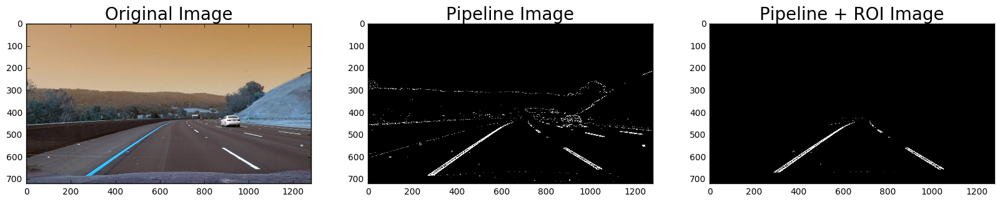

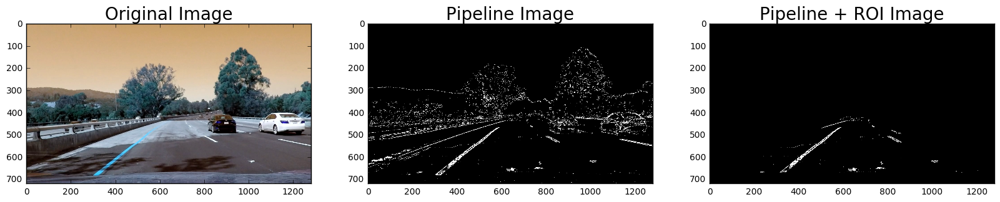

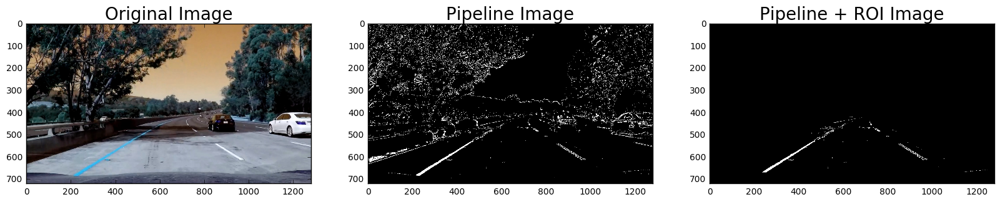

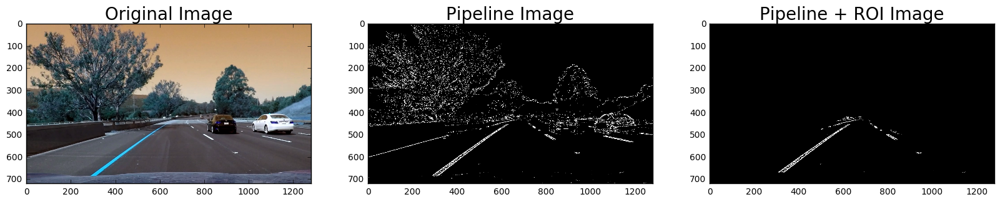

In [17]:
# Test in images
test_images = glob.glob('test_images/test*.jpg')

for idx, fname in enumerate(test_images):
    img = cv2.imread(fname)
    imshape = img.shape
    
    bottom_left = (90, imshape[0]-50)
    bottom_right = (imshape[1]-10, imshape[0]-50)
    upper_left = (610, 420)
    upper_right = (680, 420)
    
    img_pipe_all = pipeline_all (img)
    output_img = ROI(img_pipe_all,bottom_left,bottom_right, upper_left, upper_right)
    
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(img_pipe_all, cmap='gray')
    ax2.set_title('Pipeline Image', fontsize=20)
    ax3.imshow(output_img, cmap='gray')
    ax3.set_title('Pipeline + ROI Image', fontsize=20)
    
    filename = 'output_images/binary_pipeline_output' + str(idx)+'.jpg'
    scipy.misc.imsave(filename, output_img)

## Perspective transform function

In [18]:
def birds_eye_view (img,nx,ny,mtx,dist):
    imshape = img.shape
    # Firstly, we need to undistord the image
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    # We define the points of interest which will be used to do the perspective transform
    upper_left = (150+430,460)
    upper_right = (1150-440,460)
    bottom_right = (1150,720)
    bottom_left = (150,720)   
    src_points = np.array([[upper_left, upper_right,bottom_right,bottom_left]], dtype=np.float32)
    
    bottom_left = (200,720)
    bottom_right = (imshape[1]-200,720)
    upper_left = (200, 0)
    upper_right = (imshape[1]-200, 0)
    img_size = (gray.shape[1], gray.shape[0])
    dst_points = np.array([upper_left, 
                           upper_right, 
                           bottom_right, 
                           bottom_left], dtype=np.float32)
    
    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    Minv = cv2.getPerspectiveTransform(dst_points, src_points)
    # Warp the image using OpenCV warpPerspective()
    img_size = (img.shape[1], img.shape[0])
    warped = cv2.warpPerspective(undist, M, img_size)
    # Return the resulting image and matrix
    return warped,M,Minv

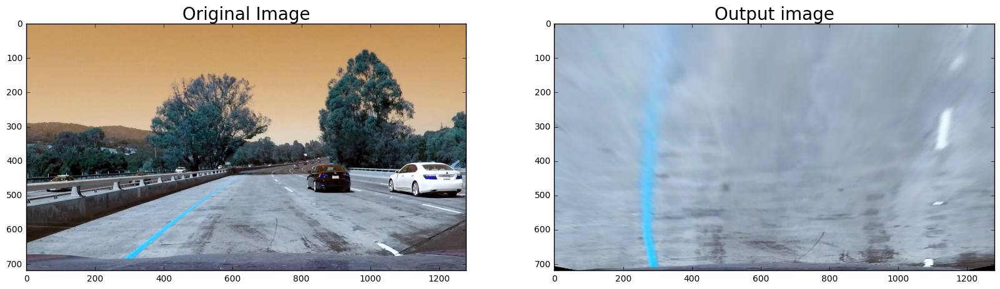

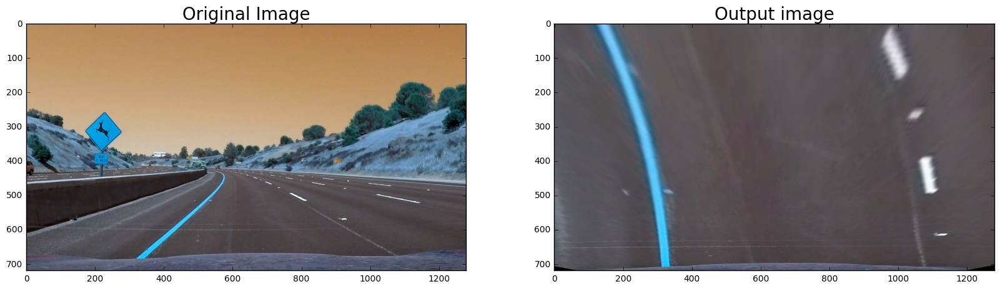

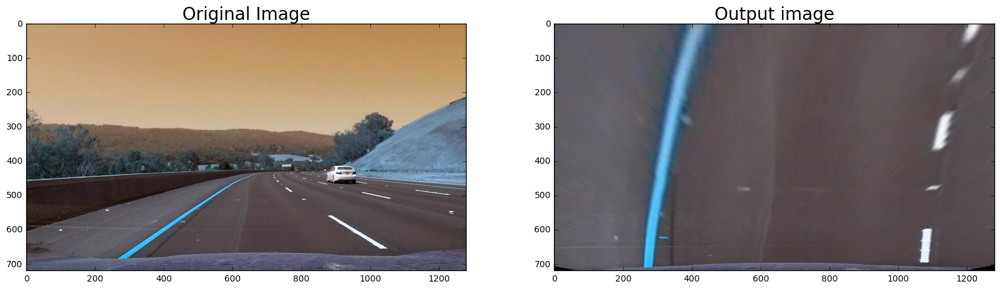

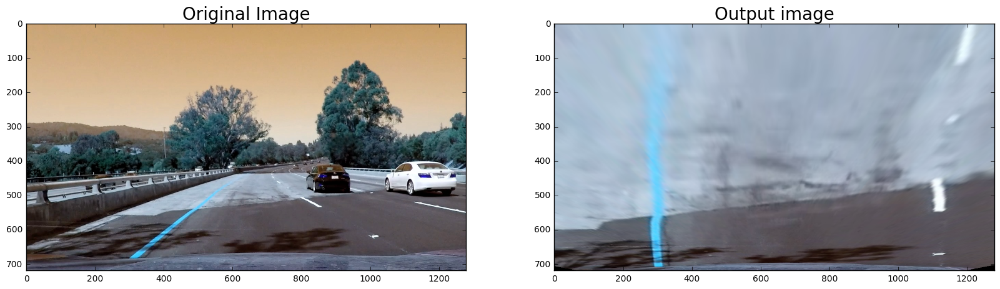

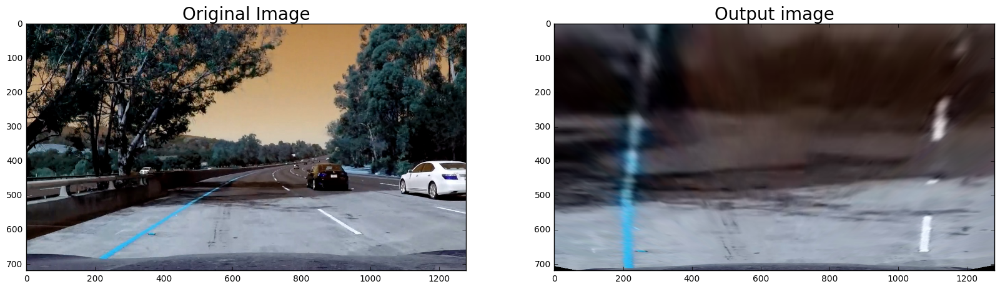

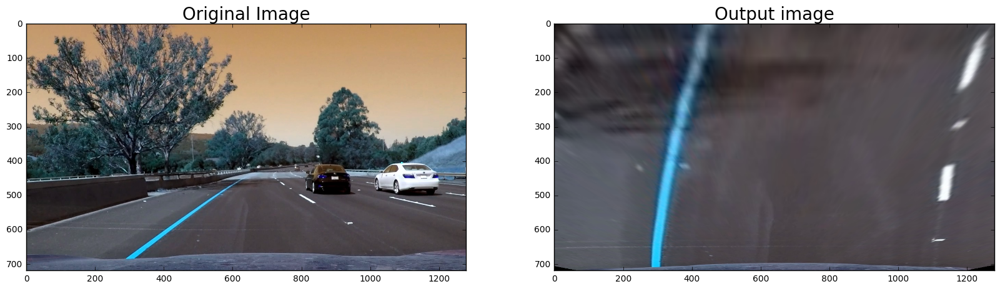

In [19]:
# Test in images
test_images = glob.glob('test_images/test*.jpg')

for idx, fname in enumerate(test_images):
    img = cv2.imread(fname)
    output_img,PerspectiveM, PerspectiveMinv = birds_eye_view (img,nx,ny,mtx,dist)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(output_img)
    ax2.set_title('Output image', fontsize=20)
    
    filename = 'output_images/perspective_transform' + str(idx)+'.jpg'
    scipy.misc.imsave(filename, output_img)

### Apply Binary threshold and Perspective Transform

c:\users\xavisilvia\appdata\local\programs\python\python35\lib\site-packages\scipy\misc\pilutil.py:96: RuntimeWarning: overflow encountered in double_scalars
  scale = float(high - low) / cscale
c:\users\xavisilvia\appdata\local\programs\python\python35\lib\site-packages\scipy\misc\pilutil.py:97: RuntimeWarning: invalid value encountered in multiply
  bytedata = (data * 1.0 - cmin) * scale + 0.4999
c:\users\xavisilvia\appdata\local\programs\python\python35\lib\site-packages\scipy\misc\pilutil.py:98: RuntimeWarning: invalid value encountered in greater
  bytedata[bytedata > high] = high
c:\users\xavisilvia\appdata\local\programs\python\python35\lib\site-packages\scipy\misc\pilutil.py:99: RuntimeWarning: invalid value encountered in less
  bytedata[bytedata < 0] = 0


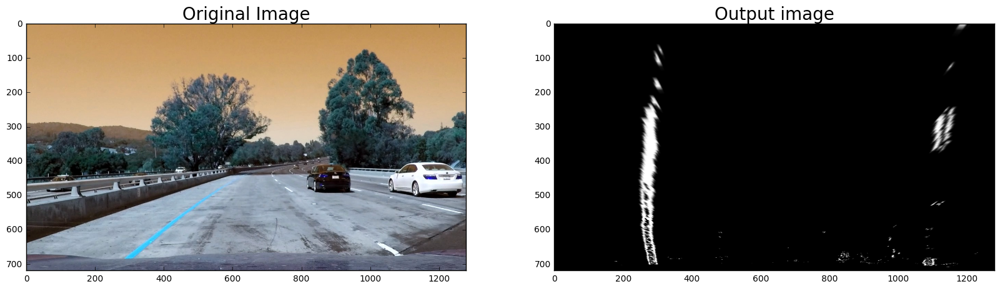

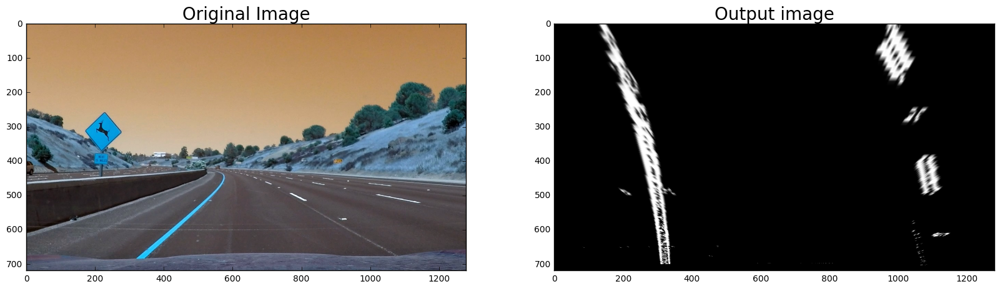

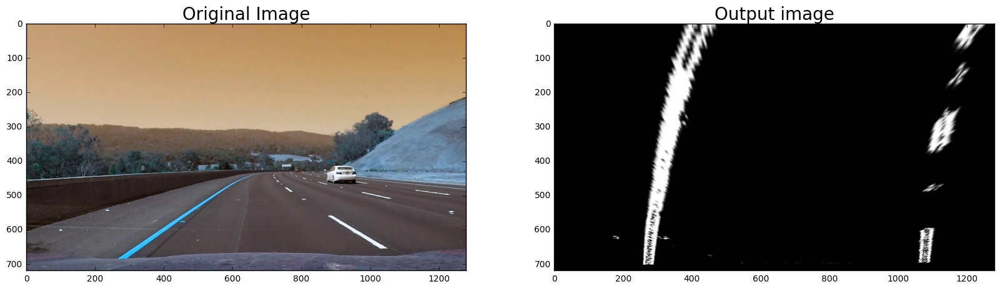

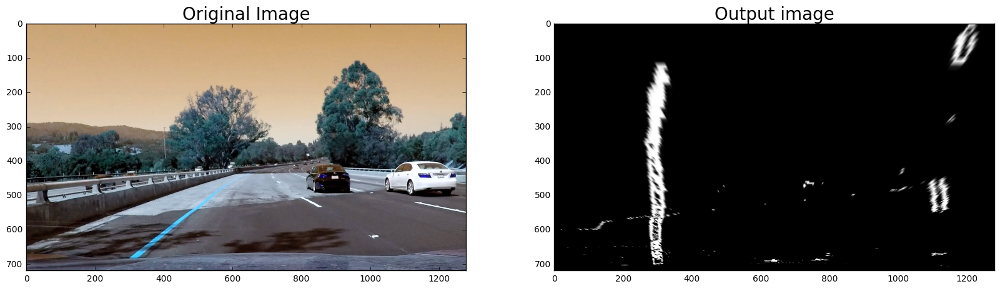

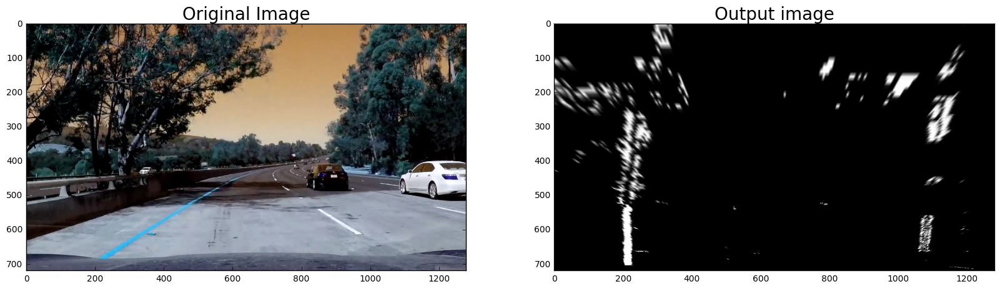

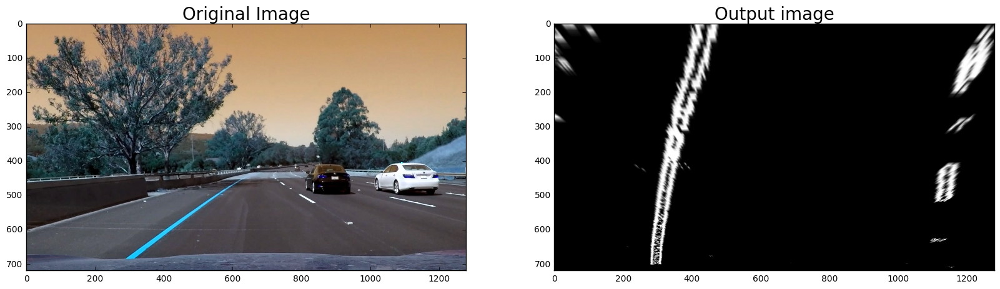

In [20]:
# Test in images
test_images = glob.glob('test_images/test*.jpg')

for idx, fname in enumerate(test_images):
    img = cv2.imread(fname)
    imshape = img.shape
    bottom_left = (90, imshape[0]-50)
    bottom_right = (imshape[1]-10, imshape[0]-50)
    upper_left = (610, 420)
    upper_right = (680, 420)
    
    img_pipe_all = pipeline_all (img)
    binary_img = ROI(img_pipe_all,bottom_left,bottom_right, upper_left, upper_right)
    
    output_img,PerspectiveM,PerspectiveMinv = birds_eye_view (binary_img,nx,ny,mtx,dist)
    f, (ax1,ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(output_img, cmap='gray')
    ax2.set_title('Output image', fontsize=20)
    filename = 'output_images/binary_perspective' + str(idx)+'.jpg'
    scipy.misc.imsave(filename, output_img)



### Detecting lane lines

In [21]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None
        
        self.windows = np.ones((3,12))*-1

In [22]:
def peaks_localization (img,window_top,window_bottom,window_left, window_right):
     # Histogram of the image
    histogram = np.sum(img[window_top:window_bottom,:], axis=0)
    # Find the max from the histogram
    if len(histogram[int(window_left):int(window_right)])>0:
        return np.argmax(histogram[int(window_left):int(window_right)]) + window_left
    else:
        return (window_left + window_right) / 2   

Peak left is  274  and Peak Right is  1083
Peak left is  306  and Peak Right is  1067
Peak left is  289  and Peak Right is  1087
Peak left is  288  and Peak Right is  1105
Peak left is  202  and Peak Right is  1082
Peak left is  309  and Peak Right is  1139


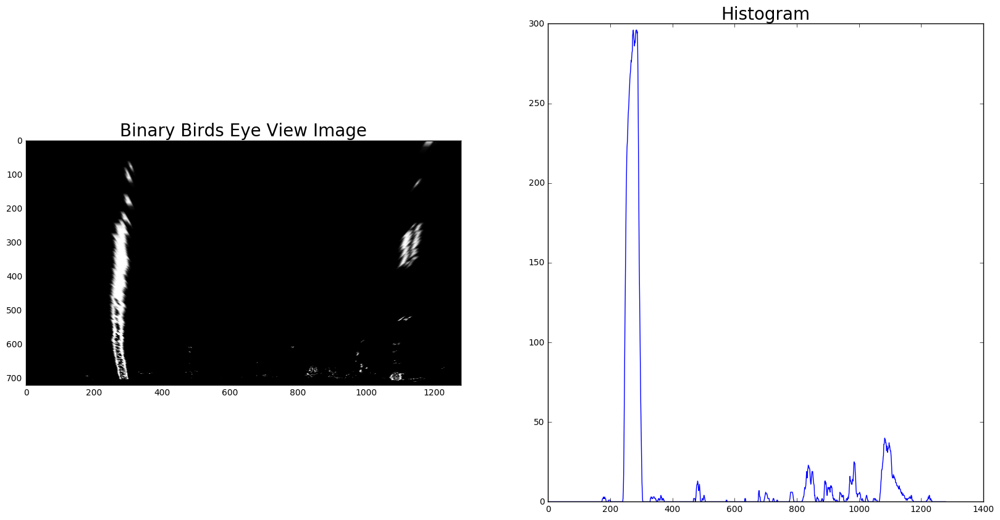

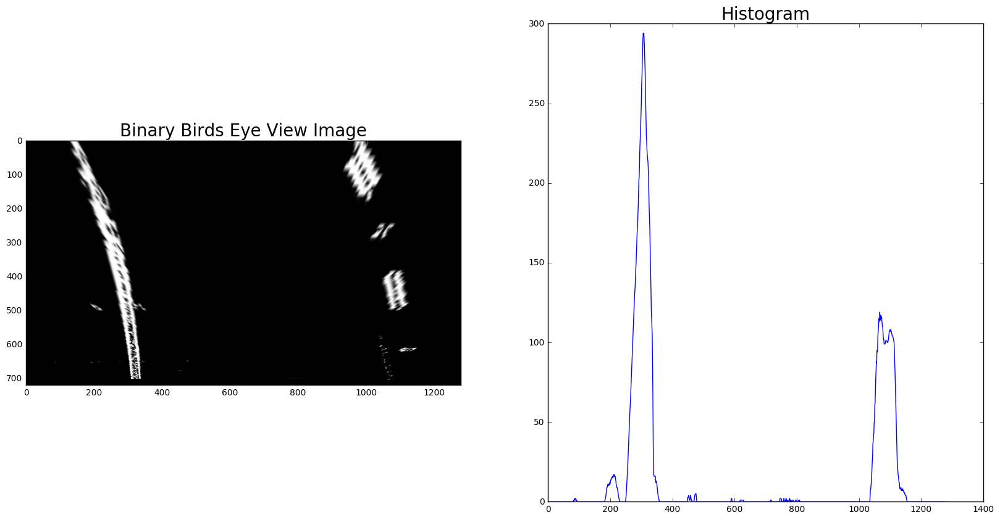

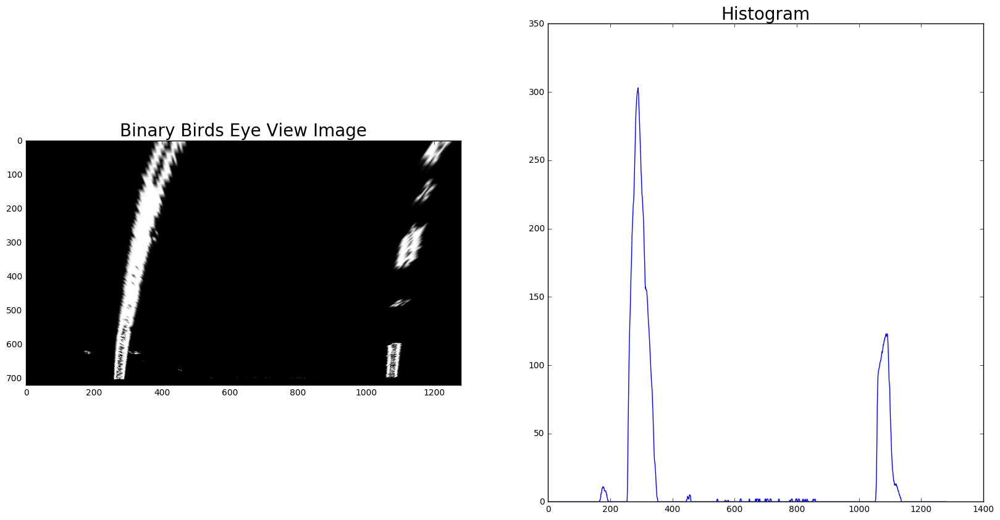

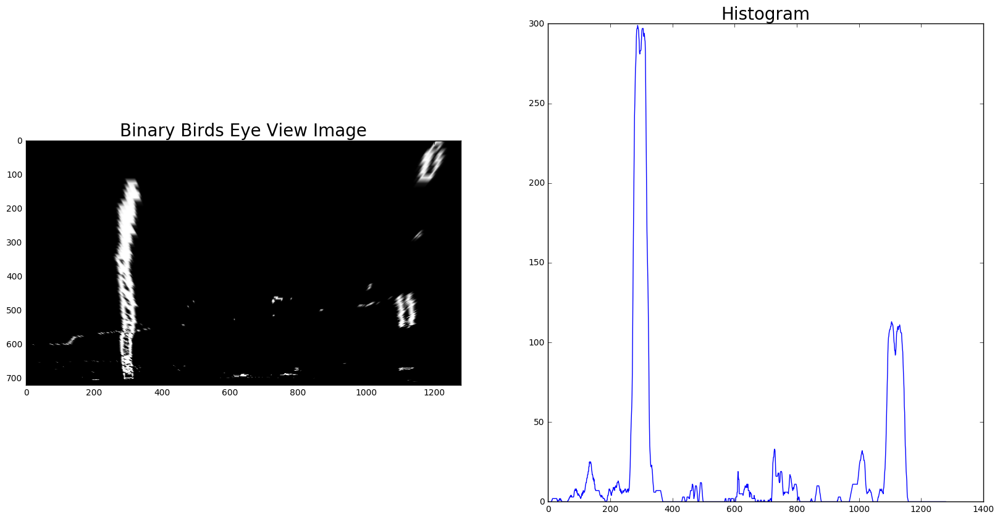

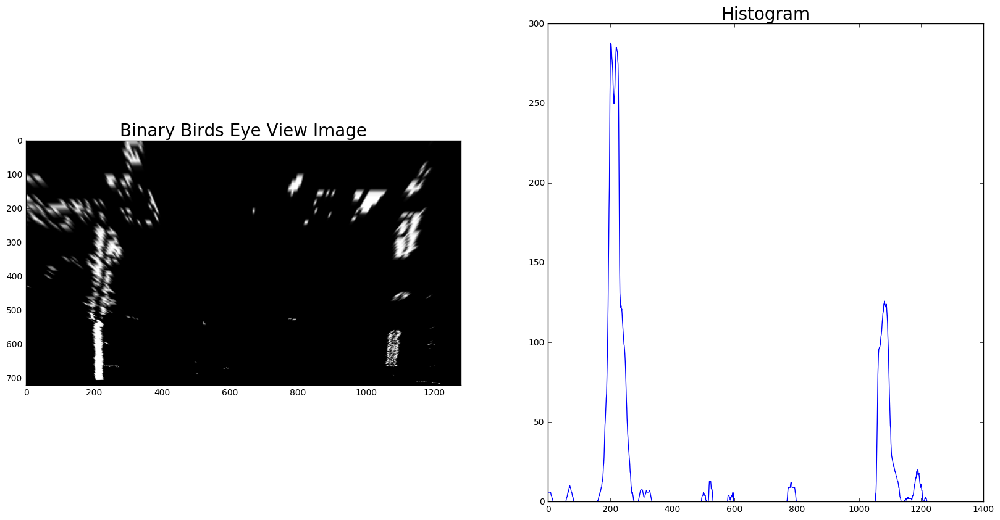

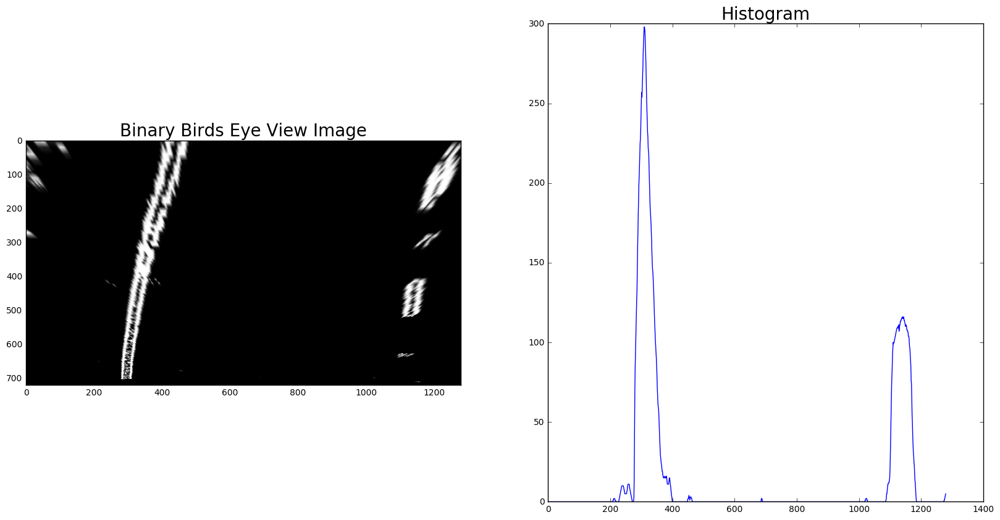

In [23]:
# Test in images
test_images = glob.glob('test_images/test*.jpg')

for idx, fname in enumerate(test_images):
    img = cv2.imread(fname)
    imshape = img.shape
    bottom_left = (90, imshape[0]-50)
    bottom_right = (imshape[1]-10, imshape[0]-50)
    upper_left = (610, 420)
    upper_right = (680, 420)
    
    img_pipe_all = pipeline_all (img)
    binary_img = ROI(img_pipe_all,bottom_left,bottom_right, upper_left, upper_right)
    
    output_img,PerspectiveM,PerspectiveMinv = birds_eye_view (binary_img,nx,ny,mtx,dist)
    top_down = output_img
    f, (ax1,ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(output_img,cmap='gray')
    ax1.set_title('Binary Birds Eye View Image', fontsize=20)
    top_down[top_down > 0] = 1
    histogram = np.sum(top_down[400:,:], axis=0)
    ax2.plot(histogram)
    ax2.set_title('Histogram', fontsize = 20)
    peak_left = peaks_localization (output_img,400,720,0, 640)
    peak_right = peaks_localization (output_img,400,720,640,1280)
    print("Peak left is ",peak_left," and Peak Right is ",peak_right)
    






In [24]:
def calc_curvature(yvals, fitx):
    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(yvals)
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meteres per pixel in x dimension
    fit_cr = np.polyfit(yvals*ym_per_pix, fitx*xm_per_pix, 2)
    curverad = ((1 + (2*fit_cr[0]*y_eval + fit_cr[1])**2)**1.5) \
                                 /np.absolute(2*fit_cr[0])
    return curverad

def calc_position(pts):
    # Find the position of the car from the center
    # It will show if the car is 'x' meters from the left or right
    position = image_shape[1]/2
    left  = np.min(pts[(pts[:,1] < position) & (pts[:,0] > 700)][:,1])
    right = np.max(pts[(pts[:,1] > position) & (pts[:,0] > 700)][:,1])
    center = (left + right)/2
    # Define conversions in x and y from pixels space to meters
    xm_per_pix = 3.7/700 # meteres per pixel in x dimension    
    return (position - center)*xm_per_pix

In [25]:
def peaks_detector (image, y_window_top, y_window_bottom, x_left, x_right):
    # Find the historgram from the image inside the window
    histogram = np.sum(image[int(y_window_top):int(y_window_bottom),:], axis=0)
    # Find the max from the histogram
    if len(histogram[int(x_left):int(x_right)])>0:
        return np.argmax(histogram[int(x_left):int(x_right)]) + x_left
    else:
        return (x_left + x_right) / 2        

def lane_checks (lane, curverad, fitx, fit):       
    # Verification for the lane
    if lane.detected: # If lane is detected
        # If verification check passes
        if abs(curverad / lane.radius_of_curvature - 1) < .6:        
            lane.detected = True
            lane.current_fit = fit
            lane.allx = fitx
            lane.bestx = np.mean(fitx)            
            lane.radius_of_curvature = curverad
            lane.current_fit = fit
        # If verification check fails use the previous values
        else:
            lane.detected = False
            fitx = lane.allx
    else:
        # If lane was not detected and no curvature is defined
        if lane.radius_of_curvature: 
            if abs(curverad / lane.radius_of_curvature - 1) < 1:            
                lane.detected = True
                lane.current_fit = fit
                lane.allx = fitx
                lane.bestx = np.mean(fitx)            
                lane.radius_of_curvature = curverad
                lane.current_fit = fit
            else:
                lane.detected = False
                fitx = lane.allx      
        # If curvature was defined
        else:
            lane.detected = True
            lane.current_fit = fit
            lane.allx = fitx
            lane.bestx = np.mean(fitx)
            lane.radius_of_curvature = curverad
    return fitx

# Sanity check for the direction
def lane_checks_direction(right, right_pre, right_pre2):
    # If the direction is ok then pass
    if abs((right-right_pre) / (right_pre-right_pre2) - 1) < .2:
        return right
    # If not then compute the value from the previous values
    else:
        return right_pre + (right_pre - right_pre2)
    
# lanes_detector function will detect left and right lanes from the warped image.
# 'n' windows will be used to identify peaks of histograms    
def lanes_detector (n, image, x_window, lanes, \
               left_lane_x, left_lane_y, right_lane_x, right_lane_y, window_ind):
    # 'n' windows will be used to identify peaks of histograms
    # Set index1. This is used for placeholder.
    index1 = np.zeros((n+1,2))
    index1[0] = [300, 1100]
    index1[1] = [300, 1100]
    # Set the first left and right values
    left, right = (300, 1100)
    # Set the center
    center = 700
    # Set the previous center
    center_pre = center
    # Set the direction
    direction = 0
    for i in range(n-1):
        # set the window range.
        y_window_top = 720-720/n*(i+1)
        y_window_bottom = 720-720/n*i
        # If left and right lanes are detected from the previous image
        if (left_lane.detected==False) and (right_lane.detected==False):
            # Find the historgram from the image inside the window
            left  = peaks_detector(image, y_window_top, y_window_bottom, index1[i+1,0]-200, index1[i+1,0]+200)
            right = peaks_detector(image, y_window_top, y_window_bottom, index1[i+1,1]-200, index1[i+1,1]+200)
            # Set the direction
            left  = lane_checks_direction(left, index1[i+1,0], index1[i,0])
            right = lane_checks_direction(right, index1[i+1,1], index1[i,1]) 
            # Set the center
            center_pre = center
            center = (left + right)/2
            direction = center - center_pre
        # If both lanes were detected in the previous image
        # Set them equal to the previous one
        else:
            left  = left_lane.windows[window_ind, i]
            right = right_lane.windows[window_ind, i]
        # Make sure the distance between left and right laens are wide enough
        if abs(left-right) > 600:
            # Append coordinates to the left lane arrays
            left_lane_array = lanes[(lanes[:,1]>=left-x_window) & (lanes[:,1]<left+x_window) &
                                 (lanes[:,0]<=y_window_bottom) & (lanes[:,0]>=y_window_top)]
            left_lane_x += left_lane_array[:,1].flatten().tolist()
            left_lane_y += left_lane_array[:,0].flatten().tolist()
            if not math.isnan(np.mean(left_lane_array[:,1])):
                left_lane.windows[window_ind, i] = np.mean(left_lane_array[:,1])
                index1[i+2,0] = np.mean(left_lane_array[:,1])
            else:
                index1[i+2,0] = index1[i+1,0] + direction
                left_lane.windows[window_ind, i] = index1[i+2,0]
            # Append coordinates to the right lane arrays            
            right_lane_array = lanes[(lanes[:,1]>=right-x_window) & (lanes[:,1]<right+x_window) &
                                  (lanes[:,0]<y_window_bottom) & (lanes[:,0]>=y_window_top)]
            right_lane_x += right_lane_array[:,1].flatten().tolist()
            right_lane_y += right_lane_array[:,0].flatten().tolist()
            if not math.isnan(np.mean(right_lane_array[:,1])):
                right_lane.windows[window_ind, i] = np.mean(right_lane_array[:,1])
                index1[i+2,1] = np.mean(right_lane_array[:,1])
            else:
                index1[i+2,1] = index1[i+1,1] + direction
                right_lane.windows[window_ind, i] = index1[i+2,1]
    return left_lane_x, left_lane_y, right_lane_x, right_lane_y

print("Accessory functions are created")

Accessory functions are created


In [26]:
import math
# Function to find the fitting lines from the warped image
def lanes_coefficients (image):
    # define y coordinate values for plotting
    yvals = np.linspace(0, 100, num=101)*7.2  # to cover same y-range as image
    # find the coordinates from the image
    lanes = np.argwhere(image)
    # Coordinates for left lane
    left_lane_x = []
    left_lane_y = []
    # Coordinates for right lane
    right_lane_x = []
    right_lane_y = []
    # Curving left or right - -1: left 1: right
    curve = 0
    # Set left and right as None
    left = None
    right = None
    # Find lanes from three repeated procedures with different window values
    left_lane_x, left_lane_y, right_lane_x, right_lane_y \
        = lanes_detector(4, image, 25, lanes, \
                     left_lane_x, left_lane_y, right_lane_x, right_lane_y, 0)
    left_lane_x, left_lane_y, right_lane_x, right_lane_y \
        = lanes_detector(6, image, 50, lanes, \
                     left_lane_x, left_lane_y, right_lane_x, right_lane_y, 1)
    left_lane_x, left_lane_y, right_lane_x, right_lane_y \
        = lanes_detector(8, image, 75, lanes, \
                     left_lane_x, left_lane_y, right_lane_x, right_lane_y, 2)
    # Find the coefficients of polynomials
    left_fit = np.polyfit(left_lane_y, left_lane_x, 2)
    left_fitx = left_fit[0]*yvals**2 + left_fit[1]*yvals + left_fit[2]
    right_fit = np.polyfit(right_lane_y, right_lane_x, 2)
    right_fitx = right_fit[0]*yvals**2 + right_fit[1]*yvals + right_fit[2]
    # Find curvatures
    left_curverad  = calc_curvature(yvals, left_fitx)
    right_curverad = calc_curvature(yvals, right_fitx)
    # Sanity check for the lanes
    left_fitx  = lane_checks(left_lane, left_curverad, left_fitx, left_fit)
    right_fitx = lane_checks(right_lane, right_curverad, right_fitx, right_fit)
    
    return yvals, left_fitx, right_fitx, left_lane_x, left_lane_y, right_lane_x, right_lane_y, left_curverad

print("lanes_coefficients are done")

lanes_coefficients are done


In [27]:
# draw poly on an image
# def draw_poly(image, warped, yvals, left_fitx, right_fitx, Minv):
image_shape = img.shape
def draw_poly(image, warped, yvals, left_fitx, right_fitx, 
              left_lane_x, left_lane_y, right_lane_x, right_lane_y, Minv, curvature):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, yvals]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, yvals])))])
    pts = np.hstack((pts_left, pts_right))
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)
    # Put text on an image
    font = cv2.FONT_HERSHEY_SIMPLEX
    text = "The curvature in meters is: {} m".format(int(curvature))
    cv2.putText(result,text,(400,100), font, 1,(255,255,255),2)
    # Find the position of the car
    pts = np.argwhere(newwarp[:,:,1])
    position = calc_position(pts)
    if position < 0:
        text = "Position is {:.2f} m left of center".format(-position)
    else:
        text = "Position is {:.2f} m right of center".format(position)
    cv2.putText(result,text,(400,150), font, 1,(255,255,255),2)
    return result

print("Draw poly on a original image")

Draw poly on a original image


In [28]:
# This function will color the image
# Input: Original image
# Output: Original image with colored region
def process_image(image):
    # Apply pipeline to the image to create black and white image
    img = pipeline_all(image)
    # Warp the image to make lanes parallel to each other
    top_down, perspective_M, perspective_Minv = birds_eye_view(img, nx, ny, mtx, dist)
    # Find the lines fitting to left and right lanes
    a, b, c, lx, ly, rx, ry, curvature = lanes_coefficients(top_down)
    # Return the original image with colored region
    return draw_poly(image, top_down, a, b, c, lx, ly, rx, ry, perspective_Minv, curvature)

c:\users\xavisilvia\appdata\local\programs\python\python35\lib\site-packages\ipykernel\__main__.py:50: RuntimeWarning: divide by zero encountered in double_scalars


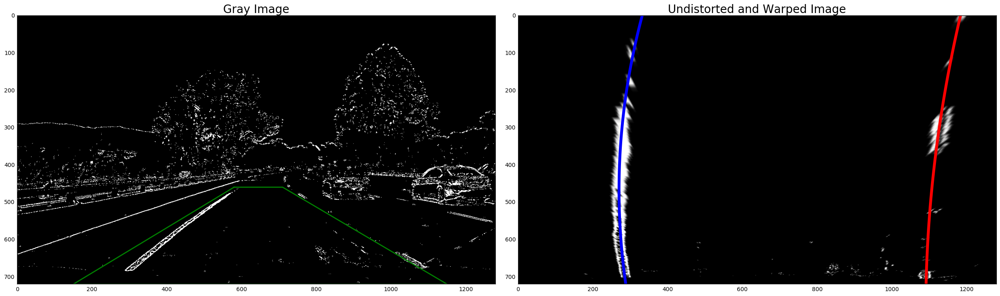

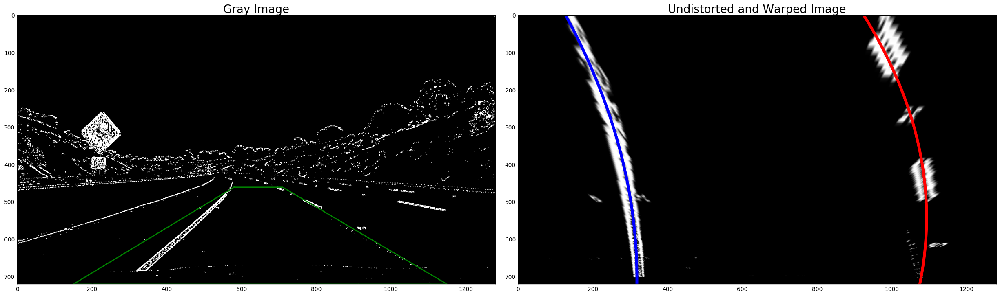

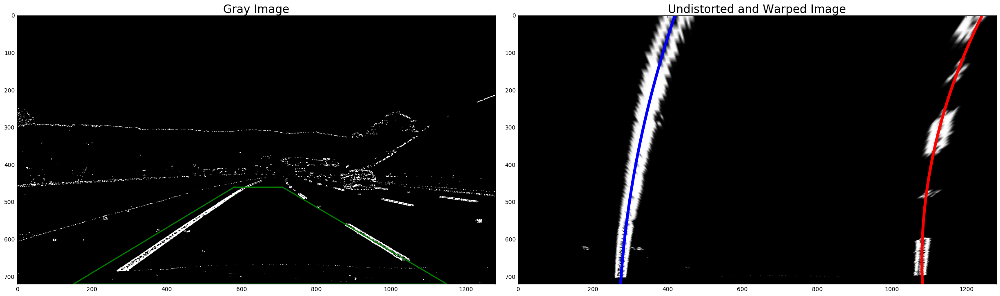

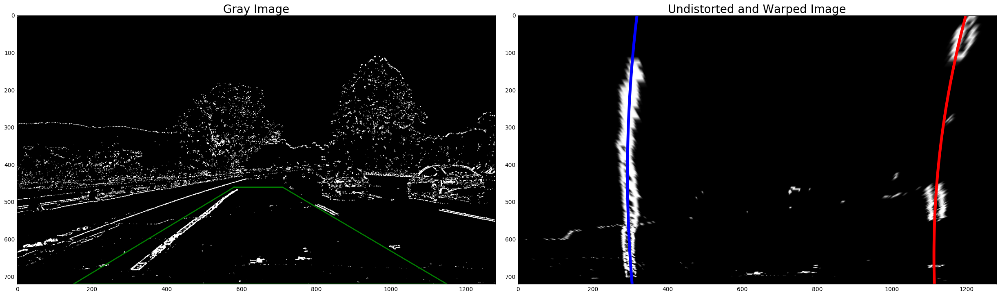

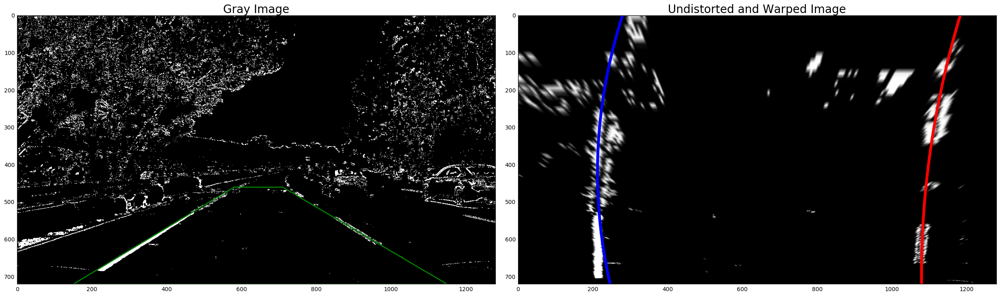

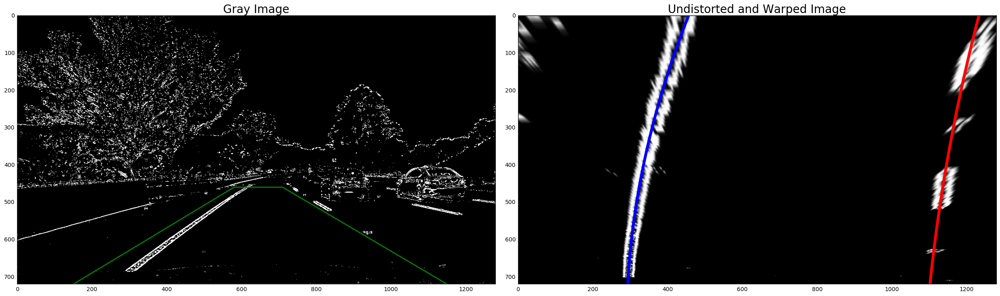

In [29]:
# These are to be used to plot lines on images
area_of_interest = [[150+430,460],[1150-440,460],[1150,720],[150,720]]
x_values = [area_of_interest[0][0],area_of_interest[1][0],area_of_interest[2][0],area_of_interest[3][0],area_of_interest[0][0]]
y_values = [area_of_interest[0][1],area_of_interest[1][1],area_of_interest[2][1],area_of_interest[3][1],area_of_interest[0][1]]
test_images = glob.glob('test_images/test*.jpg')
# Plot 6 example images and warp them
for i,fname in enumerate(test_images):
    # Set up lines for left and right
    left_lane = Line()
    right_lane = Line()
    # load the image
    #fname = 'test_images/test{}.jpg'.format(i)
    img_raw = cv2.imread(fname)
    # Apply pipeline to the image to create black and white image
    img = pipeline_all(img_raw)
    binary_img = ROI(img,bottom_left,bottom_right, upper_left, upper_right)
    
    top_down,PerspectiveM,PerspectiveMinv = birds_eye_view (binary_img,nx,ny,mtx,dist)
    # Unwrap the image
    #top_down, perspective_M, perspective_Minv = corners_unwarp(img, nx, ny, mtx, dist)
    # Set up for the subplots
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    # Showing the image from pipeline with marked areas
    ax1.set_title('Gray Image', fontsize=20)
    ax1.plot(x_values,y_values,'g-',lw=2)
    ax1.imshow(img, cmap='gray')
    # Find lanes from the warped image
    a, b, c, _, _, _, _, _ = lanes_coefficients(top_down)
    ax2.plot(b, a, color='blue', linewidth=5)
    ax2.plot(c, a, color='red', linewidth=5)
    ax2.imshow(top_down, cmap='gray')
    ax2.set_title('Undistorted and Warped Image', fontsize=20)
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)   

### Adding detected lanes to the raw image

c:\users\xavisilvia\appdata\local\programs\python\python35\lib\site-packages\ipykernel\__main__.py:50: RuntimeWarning: divide by zero encountered in double_scalars


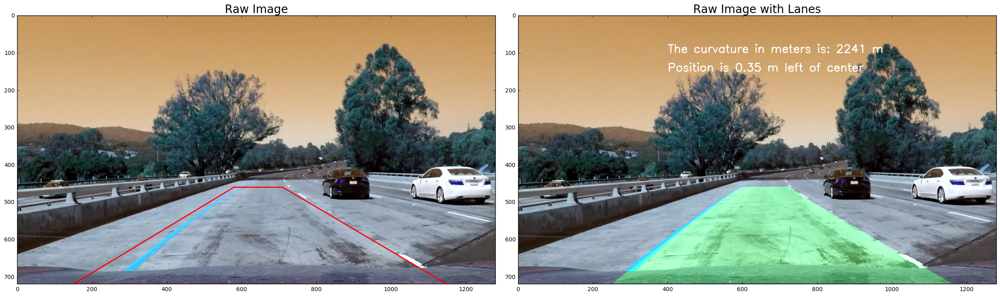

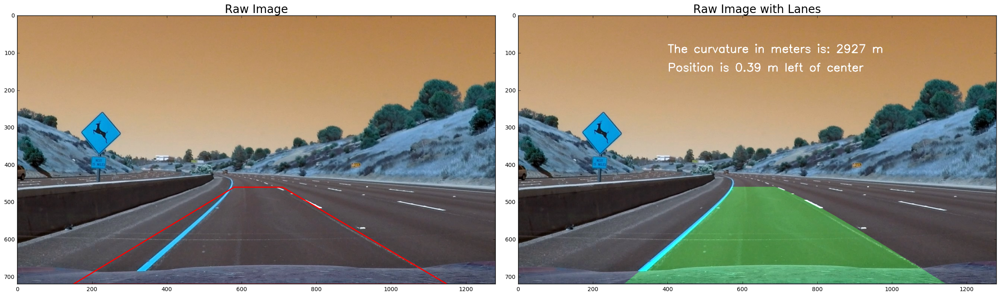

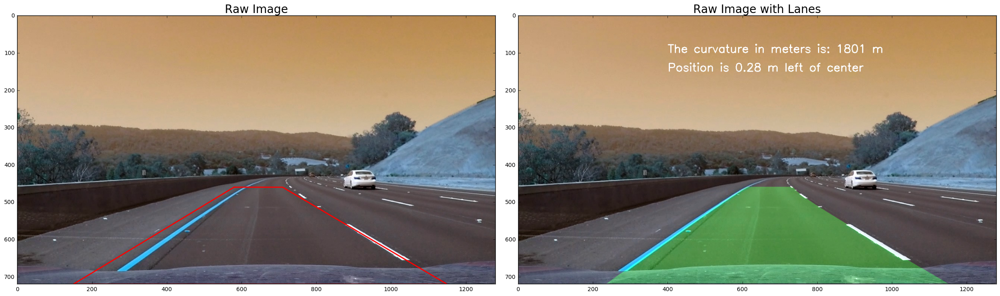

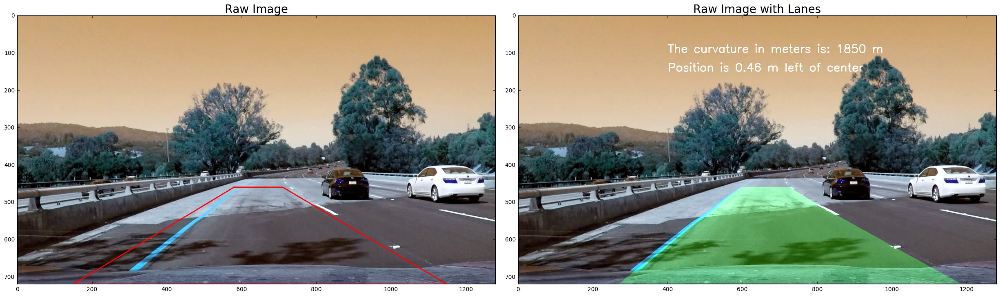

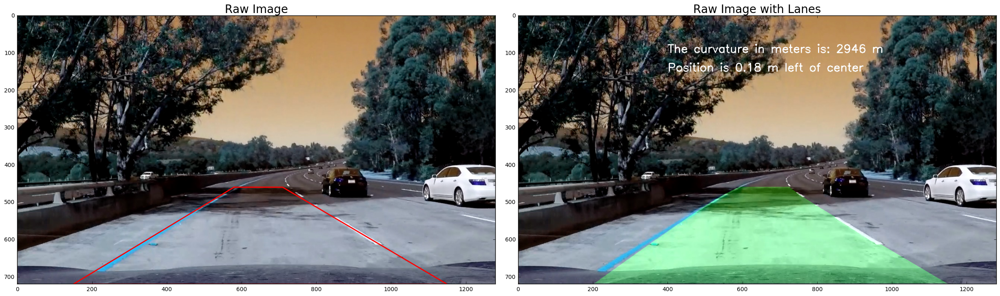

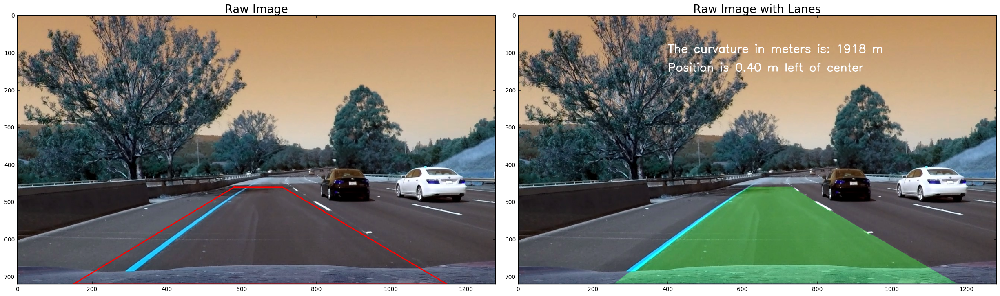

In [30]:
# Plot 6 example images and warp them
for i,fname in enumerate(test_images):
    # Set up lines for left and right
    left_lane = Line()
    right_lane = Line()
    # load the image
    #fname = 'test_images/test{}.jpg'.format(i)
    img_raw = cv2.imread(fname)
    # Apply pipeline to the image to create black and white image
    img = pipeline_all(img_raw)
    binary_img = ROI(img,bottom_left,bottom_right, upper_left, upper_right)
    
    top_down,PerspectiveM,PerspectiveMinv = birds_eye_view (binary_img,nx,ny,mtx,dist)
    RawImage_with_Lanes = process_image (img_raw)  
    # Set up for the subplots
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    # Showing the image from pipeline with marked areas
    ax1.set_title('Raw Image', fontsize=20)
    ax1.plot(x_values,y_values,'r-',lw=2)
    ax1.imshow(img_raw)
    ax2.imshow(RawImage_with_Lanes)
    ax2.set_title('Raw Image with Lanes', fontsize=20)
    filename1 = 'output_images/rawImage' + str(i)+'.jpg'
    scipy.misc.imsave(filename1, img_raw)
    filename2 = 'output_images/RawImagewithLanes' + str(i)+'.jpg'
    scipy.misc.imsave(filename2, RawImage_with_Lanes)
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)   
    
    



### Video Processing

In [31]:
### Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML
# Set up lines for left and right
left_lane = Line()
right_lane = Line()
white_output = 'white.mp4'
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video white.mp4
[MoviePy] Writing video white.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [10:53<00:00,  1.54it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: white.mp4 

Wall time: 10min 57s
